### UMAP, K-means and HDBSscan


####**UMAP**

- Creates k-NN graph as all-neighbors graph to embedd high-dimensional data into lower dimensions.
- Embedding, dimentionality reduction and scale
- EDA for feature discovery, pre-processing, clustering and analysis.

GPU-Accelerate with cuML, end-to-end GPU workflow.

####GPU UMAP

In [ ]:
import sys, os, shutil
from IPython import get_ipython
# Install plotly for interactive visualizations
!pip install plotly
!pip install --upgrade scipy scikit-learn

[2026-01-16 09:02:12.628] [CUML] [info] Building knn graph using brute force (configured from build_algo='auto')
[2026-01-16 09:02:12.698] [CUML] [info] Building knn graph using brute force (configured from build_algo='auto')


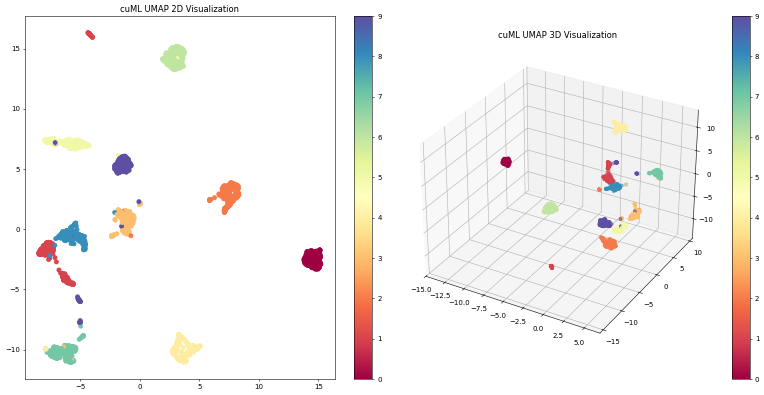

In [ ]:
import matplotlib.pyplot as plt
from sklearn.datasets import load_digits
from cuml.manifold import UMAP  # Changed to import UMAP from cuML
from cuml.cluster import KMeans
import matplotlib.pyplot as plt

# Load example data (handwritten digits dataset)
data, labels = load_digits(return_X_y=True)

# cuML UMAP for 2D and 3D visualization
umap_2d = UMAP(n_neighbors=15, min_dist=0.1, n_components=2)
embedding_2d = umap_2d.fit_transform(data)
umap_3d = UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
embedding_3d = umap_3d.fit_transform(data)

# Create a single figure with two subplots
fig = plt.figure(figsize=(16, 8), dpi=50) # Adjust figure size for two plots

# Subplot for 2D embedding
ax1 = fig.add_subplot(121) # 1 row, 2 columns, 1st subplot
scatter_2d = ax1.scatter(embedding_2d[:, 0], embedding_2d[:, 1], c=labels, cmap='Spectral')
fig.colorbar(scatter_2d, ax=ax1)
ax1.set_title("cuML UMAP 2D Visualization")

# Subplot for 3D embedding
ax2 = fig.add_subplot(122, projection='3d') # 1 row, 2 columns, 2nd subplot
scatter_3d = ax2.scatter(embedding_3d[:, 0], embedding_3d[:, 1], embedding_3d[:,2], c=labels, cmap='Spectral')
fig.colorbar(scatter_3d, ax=ax2)
ax2.set_title("cuML UMAP 3D Visualization")

plt.tight_layout() # Adjust layout to prevent overlapping titles/labels
plt.show()


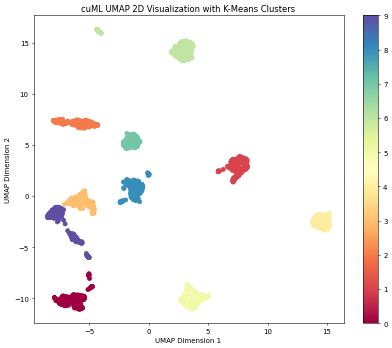

In [ ]:
# Apply K-means clustering to the 2D UMAP embeddings
kmeans_model = KMeans(n_clusters=10, random_state=0) # Assuming 10 clusters for digits dataset
cluster_labels = kmeans_model.fit_predict(embedding_2d)

# Visualize the 2D UMAP embedding with K-means clusters
plt.figure(figsize=(10, 8), dpi=50)
scatter = plt.scatter(embedding_2d[:, 0], embedding_2d[:, 1], c=cluster_labels, cmap='Spectral')
plt.colorbar(scatter)
plt.title("cuML UMAP 2D Visualization with K-Means Clusters")
plt.xlabel("UMAP Dimension 1")
plt.ylabel("UMAP Dimension 2")
plt.show()

###**K-means**  

- Assign data points to nearest cluster. Compute distances between each data point - handle these distance calculations with GPU.
- Update cluster centroids. Recalculate the centroids taking means and using the parallel reduction algorithms.
- Check and repeat until convergence.

Perform K-means clustering using cuML. Reduce dimensionality using cuML UMAP

####GPU K-Means

In [ ]:
#%load_ext cuml.accel
from sklearn.datasets import make_blobs
from cuml.cluster import KMeans # Changed to import KMeans from cuML
from time import time
import cupy as cp

n_samples = 1_000_000
n_features = 10
n_clusters = 5
random_state = 42
n_init = 10
# generate synthetic data
X, _ = make_blobs(n_samples = n_samples, centers = n_clusters, n_features = n_features, random_state = random_state)
print(f'Data shape {X.shape}')
# convert NumPy array to a CuPy array for GPU processing
X_gpu = cp.asarray(X)
start_time = time()
# initialize cuML's KMeans
kmeans = KMeans(n_clusters = n_clusters, random_state = random_state, n_init = n_init)
kmeans.fit(X_gpu)
cluster_labels = kmeans.labels_
end_time = time()
# convert the cluster centers from a CuPy array back to a NumPy array
cluster_centers = cp.asnumpy(kmeans.cluster_centers_)
inertia = kmeans.inertia_

Data shape (1000000, 10)


####cuML K-Means with cuML UMAP

In [ ]:
# generate the data
X, labels = make_blobs(n_samples=n_samples, n_features=n_features, centers=n_clusters, cluster_std=0.5, random_state=random_state)
# covert data to PGU array using CuPy
X_gpu = cp.asarray(X)
kmeans = KMeans(n_clusters=5, random_state=42, n_init=50)
kmeans.fit(X_gpu.get())
cluster_labels = kmeans.labels_
# reduce dimensionality to 3D with cuML UMAP
umap3D = UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
embedding_3d = umap3D.fit_transform(X_gpu.get())
# convert GPU array back to NumPy for visualization
embedding_3d = cp.asnumpy(embedding_3d)
cluster_labels_cpu = cp.asnumpy(cluster_labels)

# interactive visualization
import plotly.express as px
fig = px.scatter_3d(
    x=embedding_3d[:, 0],
    y=embedding_3d[:, 1],
    z=embedding_3d[:, 2],
    color=cluster_labels_cpu.astype(str),
    title="3D UMAP Visualization with K-Means Clusters",
    labels={'color': 'Cluster'}
)

fig.update_traces(marker=dict(size=5))
fig.update_layout(scene=dict(
    xaxis_title='UMAP Dimension 1',
    yaxis_title='UMAP Dimension 2',
    zaxis_title='UMAP Dimension 3',
))

fig.show()

[2026-01-16 09:41:08.586] [CUML] [info] Building knn graph using nn descent (configured from build_algo='auto')


###**HDBSCAN**

HDBSCAN Algorithm
- Build a minimum spanning tree of distances - Fully Accelerated GPU for for k-nearest neighbors (k-NN) distance graph, mutual reachability graph and minimum spanning tree (MST). GPU-accelerated - cuML.
- Hierarchical Clustering - Optimized for GPUs with parallel processing
- Condense the Hierarchy, dendogram extract - Parallelized on GPU for fast condensation
- Extract Clusters - Cluster selection fully parallelized on GPU
- Convergence - Faster convergence with GPU-based computations

GPU DBSCAN

In [ ]:
# Install cuml library with CUDA 11 support
!pip install cuml-cu11 --extra-index-url=https://pypi.nvidia.com > /dev/null/
# Install cudf library with CUDA 11 support
!pip install cudf-cu11 --extra-index-url=https://pypi.nvidia.com >/dev/null/
# Then load the cudf.pandas extension
%load_ext cudf.pandas

In [ ]:
import sys, os, shutil
from IPython import get_ipython
import pandas as pd
import cupy as cp
# Install plotly for interactive visualizations
!pip install plotly > /dev/null
!pip install --upgrade scipy scikit-learn > /dev/null

import matplotlib.pyplot as plt

In [ ]:
# Then load the cuml.accel extension
%load_ext cuml.accel

In [ ]:
from sklearn.datasets import make_blobs
from hdbscan import HDBSCAN
from umap import UMAP
from time import time
import plotly.express as px
from sklearn.metrics import silhouette_score

n_samples = 10_000
n_features = 10
n_clusters = 5
random_state = 42

X, _ = make_blobs(
    n_samples=n_samples,
    centers=n_clusters,
    n_features=n_features,
    random_state = random_state
)

X_gpu = cp.asarray(X)

start_time = time()
hdbscan_model = HDBSCAN(min_samples=10, min_cluster_size=100, gen_min_span_tree=True).fit(X_gpu.get())
end_time = time()

labels = cp.asnumpy(hdbscan_model.labels_)
n_clusters_found = len(set(labels)) - (1 if -1 in labels else 0)
print(f'hdbscan complete in {end_time - start_time}')
print(f'number if clusters {n_clusters}')
print(f'cluster labels (first 10) {labels[:10]}')

hdbscan complete in 0.5384521484375
number if clusters 5
cluster labels (firsr 10) [1 4 0 0 3 4 2 0 1 1]


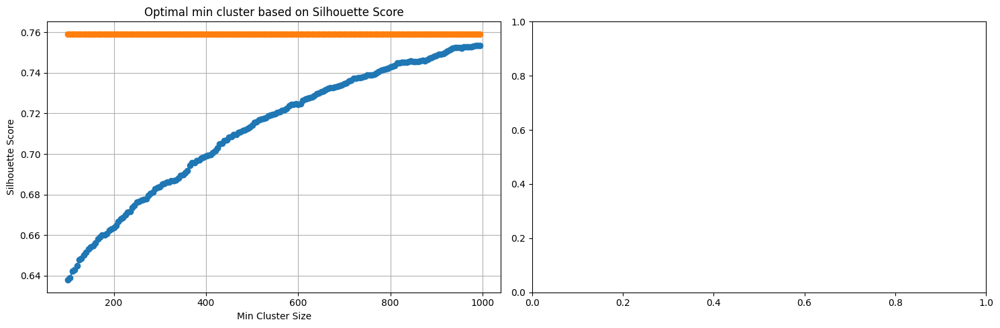

In [ ]:
# try different min cluster size
min_cluster_sizes = range(100, 1000, 5)
persistence_scores, silhouette_scores = [], []

for size in min_cluster_sizes:
    clusterer = HDBSCAN(min_samples=10, min_cluster_size=size, gen_min_span_tree=True)
    clusterer.fit(X_gpu.get())
    p = clusterer.cluster_persistence_
    persistence_scores.append(cp.mean(p).item())
    labels = clusterer.labels_
    s = silhouette_score(X_gpu.get(), labels)
    silhouette_scores.append(s)

fig, ax = plt.subplots(1, 2, figsize=(15, 5))

ax[0].plot(min_cluster_sizes, persistence_scores, marker= 'o', linestyle='-')
ax[0].set_title('Optimal min cluster based on Persistence Score')
ax[0].set_xlabel('Min Cluster Size') ; ax[0].set_ylabel('Persistence Score')
ax[0].grid(True)

ax[0].plot(min_cluster_sizes, silhouette_scores, marker= 'o', linestyle='-')
ax[0].set_title('Optimal min cluster based on Silhouette Score')
ax[0].set_xlabel('Min Cluster Size') ; ax[0].set_ylabel('Silhouette Score')
ax[0].grid(True)
plt.tight_layout() ; plt.show()

In [ ]:
hdbscan = HDBSCAN(min_samples=10, min_cluster_size=200, gen_min_span_tree=True)
hdbscan.fit(X_gpu.get())
umap_3d = UMAP(n_neighbors=15, min_dist=0.1, n_components=3)
embedding_3d = umap_3d.fit_transform(X_gpu.get())
embedding_3d_cpu = cp.asnumpy(embedding_3d)
cluster_labels = hdbscan.labels_
cluster_labels_cpu = cp.asnumpy(cluster_labels)

fig = px.scatter_3d(
    x=embedding_3d_cpu[:, 0],
    y=embedding_3d_cpu[:, 1],
    z=embedding_3d_cpu[:, 2],
    color=cluster_labels_cpu,
    opacity=0.7,
    color_continuous_scale=px.colors.qualitative.Plotly,
    title='HDBSCAN Clustering Results 3D scattering',
    labels={'x': 'Dimension 1', 'y': 'Dimension 2', 'z': 'Dimension 3'}
)
fig.update_traces(marker=dict(size=5))
fig.show()